# SPEECH EMOTION RECOGNITION SYSTEM

**PROJECT OVERVIEW**

Through all the available senses humans can actually sense the emotional state of their communication partner. The emotional detection is natural for humans but it is very difficult task for computers; although they can easily understand content based information, accessing the depth behind content is difficult and that’s what speech emotion recognition (SER) sets out to do. It is a system through which various audio speech files are classified into different emotions such as happy, sad, anger and neutral by computer. SER can be used in areas such as the medical field or customer call centers.

**DATASET**

The Ryerson Audio-Visual Database of Emotional Speech and Song (RAVDESS) Dataset from Kaggle contains 1440 audio files from 24 Actors vocalizing two lexically-matched statements. Emotions include angry, happy, sad, fearful, calm, neutral, disgust, and surprised.[Dataset](https://www.kaggle.com/datasets/uwrfkaggler/ravdess-emotional-speech-audio)

### STEP 1 - IMPORT DEPENDENCIES LIBRARIES

In [1]:
#Install all the Reqiuired Libraries and Packages 
import os
import glob
from tqdm import tqdm
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.io import wavfile
from python_speech_features import mfcc , logfbank
import pickle
import librosa
from scipy import signal
import noisereduce as nr
import librosa.display
import soundfile as sf
from IPython.display import Audio
get_ipython().magic('matplotlib inline')
import soundfile
from sklearn.utils.class_weight import compute_class_weight
from sklearn.model_selection import train_test_split
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import accuracy_score

import warnings
warnings.simplefilter("ignore")

### STEP 2 - LOAD THE RAVDESS DATASET

In [2]:
#Loading the required RAVDESS DataSet with length of 1439 Audio Files 
os.listdir(path='.\speech-emotion-recognition-ravdess-data')
def getListOfFiles(dirName):
    listOfFile=os.listdir(dirName)
    allFiles=list()
    for entry in listOfFile:
        fullPath=os.path.join(dirName, entry)
        if os.path.isdir(fullPath):
            allFiles=allFiles + getListOfFiles(fullPath)
        else:
            allFiles.append(fullPath)
    return allFiles

dirName = './speech-emotion-recognition-ravdess-data'
listOfFiles = getListOfFiles(dirName)
len(listOfFiles)

1440

**Male Neutral**

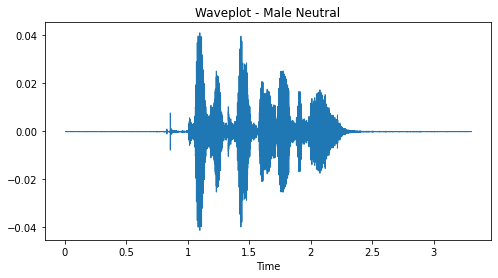

In [24]:
#Male Neutral

# LOAD IN FILE
x, sr = librosa.load('D:/Minor Project/speech-emotion-recognition-ravdess-data/Actor_01/03-01-01-01-01-01-01.wav')

# DISPLAY WAVEPLOT
plt.figure(figsize=(8, 4))
librosa.display.waveshow(x, sr=sr)
plt.title('Waveplot - Male Neutral')
plt.savefig('Waveplot_MaleNeutral.png')

# PLAY AUDIO FILE

sf.write('D:/Minor Project/speech-emotion-recognition-ravdess-data/Actor_01/03-01-01-01-01-01-01.wav', x,sr)
Audio(data=x, rate=sr)

**Female Calm**

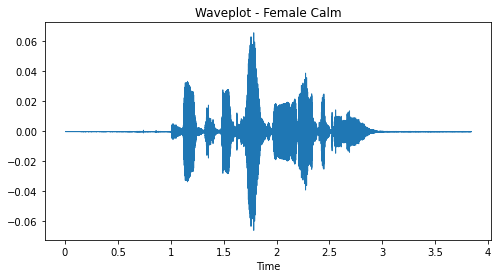

In [25]:
#Female Calm

# LOAD IN FILE
x, sr = librosa.load('D:/Minor Project/speech-emotion-recognition-ravdess-data/Actor_02/03-01-02-01-01-01-02.wav')

# DISPLAY WAVEPLOT
plt.figure(figsize=(8, 4))
librosa.display.waveshow(x, sr=sr)
plt.title('Waveplot - Female Calm')
plt.savefig('Waveplot_FemaleCalm.png')

# PLAY AUDIO FILE
sf.write('D:/Minor Project/speech-emotion-recognition-ravdess-data/Actor_02/03-01-02-01-01-01-02.wav', x,sr)
Audio(data=x, rate=sr)

**Male Happy**

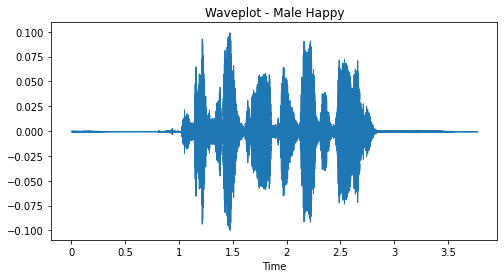

In [26]:
#Male Happy

# LOAD IN FILE
x, sr = librosa.load('D:/Minor Project/speech-emotion-recognition-ravdess-data/Actor_03/03-01-03-01-01-01-03.wav')

# DISPLAY WAVEPLOT
plt.figure(figsize=(8, 4))
librosa.display.waveshow(x, sr=sr)
plt.title('Waveplot - Male Happy')
plt.savefig('Waveplot_MaleHappy.png')

# PLAY AUDIO FILE

sf.write('D:/Minor Project/speech-emotion-recognition-ravdess-data/Actor_03/03-01-03-01-01-01-03.wav', x,sr)
Audio(data=x, rate=sr)

**Female Sad**

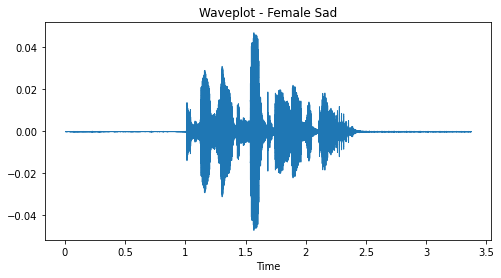

In [27]:
#Female Sad

# LOAD FILE
x, sr = librosa.load('D:/Minor Project/speech-emotion-recognition-ravdess-data/Actor_04/03-01-04-01-01-01-04.wav')

# DISPLAY WAVEPLOT
plt.figure(figsize=(8, 4))
librosa.display.waveshow(x, sr=sr)
plt.title('Waveplot - Female Sad')
plt.savefig('Waveplot_FemaleSad.png')

# PLAY AUDIO FILE
sf.write('D:/Minor Project/speech-emotion-recognition-ravdess-data/Actor_04/03-01-04-01-01-01-04.wav', x, sr)
Audio(data=x, rate=sr)

**Male Angry**

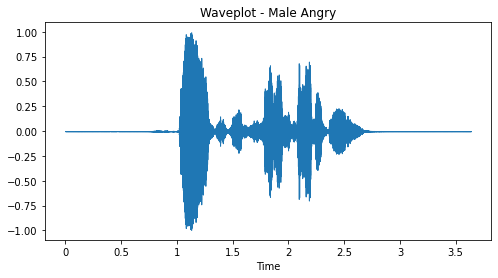

In [28]:
#Male Angry

# LOAD FILE
x, sr = librosa.load('D:/Minor Project/speech-emotion-recognition-ravdess-data/Actor_05/03-01-05-02-02-01-05.wav')

# DISPLAY WAVEPLOT
plt.figure(figsize=(8, 4))
librosa.display.waveshow(x, sr=sr)
plt.title('Waveplot - Male Angry')
plt.savefig('Waveplot_MaleAngry.png')

# PLAY AUDIO FILE
sf.write('D:/Minor Project/speech-emotion-recognition-ravdess-data/Actor_05/03-01-05-01-01-01-02.wav', x, sr)
Audio(data=x, rate=sr)

**Female Fearful**

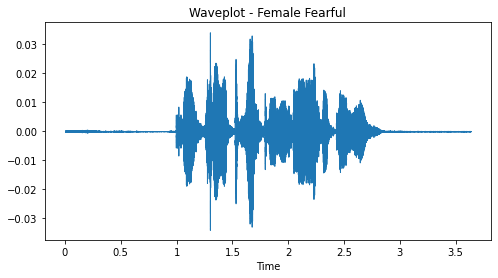

In [29]:
#Female Fearful

# LOAD FILE
x, sr = librosa.load('D:/Minor Project/speech-emotion-recognition-ravdess-data/Actor_06/03-01-06-01-01-01-06.wav')

# DISPLAY WAVEPLOT
plt.figure(figsize=(8, 4))
librosa.display.waveshow(x, sr=sr)
plt.title('Waveplot - Female Fearful')
plt.savefig('Waveplot_FemaleFearful.png')

# PLAY AUDIO FILE
sf.write('D:/Minor Project/speech-emotion-recognition-ravdess-data/Actor_06/03-01-06-01-01-01-06.wav', x, sr)
Audio(data=x, rate=sr)

**Male Disgust**

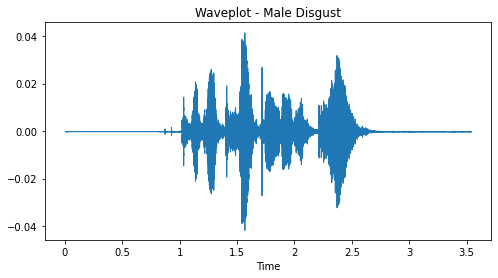

In [30]:
#Male Disgust

# LOAD FILE
x, sr = librosa.load('D:/Minor Project/speech-emotion-recognition-ravdess-data/Actor_07/03-01-07-01-01-01-07.wav')

# DISPLAY WAVEPLOT
plt.figure(figsize=(8, 4))
librosa.display.waveshow(x, sr=sr)
plt.title('Waveplot - Male Disgust')
plt.savefig('Waveplot_MaleDisgust.png')

# PLAY AUDIO FILE
sf.write('D:/Minor Project/speech-emotion-recognition-ravdess-data/Actor_07/03-01-07-01-01-01-07.wav', x, sr)
Audio(data=x, rate=sr)

**Female Surprised**

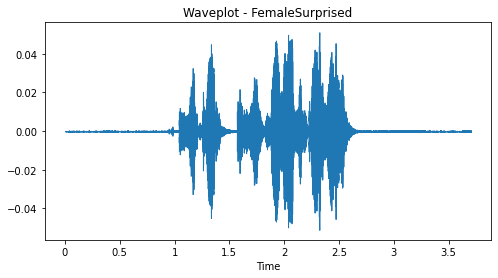

In [31]:
#Female Surprised

# LOAD FILE
x, sr = librosa.load('D:/Minor Project/speech-emotion-recognition-ravdess-data/Actor_08/03-01-08-01-01-01-08.wav')

# DISPLAY WAVEPLOT
plt.figure(figsize=(8, 4))
librosa.display.waveshow(x, sr=sr)
plt.title('Waveplot - FemaleSurprised')
plt.savefig('Waveplot_FemaleSurprised.png')

# PLAY AUDIO FILE
sf.write('D:/Minor Project/speech-emotion-recognition-ravdess-data/Actor_08/03-01-08-01-01-01-08.wav', x, sr)
Audio(data=x, rate=sr)

### STEP 3 - USING SPEECH RECOGNITION API TO CONVERT AUDIO TO TEXT

In [3]:
#Use the Speech-Recognition API to get the Raw Text from Audio Files, Though Speech Recognition
#is less strong for large chunk of files , so used Error Handling , where when it is not be able to 
#produce the text of a particular Audio File it prints the statement 'error'.Just for understanding Audio
import speech_recognition as sr
r=sr.Recognizer()
for file in range(0 , len(listOfFiles) , 1):
    with sr.AudioFile(listOfFiles[file]) as source:
        audio = r.listen(source)
        try:
            text = r.recognize_google(audio)
            print(text)
        except:
            print('error')

talking by the door
kids talking by the door
dogs sitting by the door
talk to Siri why the door
error
talking by the door
by the door
dogs sitting by the door
change your talking by the door
kids are talking by the door
dog sitting by the door
sitting by the door
kids talking by the door
talking by the door
dogs sitting by the door
dogs are sitting by the door
talking by the door
error
sitting by the door
dogs are sitting by the door
kids talking by the door
khesa talking by the door
sitting by the door
error
kids are talking by the door
talking by the door
dogs are sitting by the door
sitting by the door
kids or talking by the door
a talking by the door
sitting by the door
sitting by the door
talking by the door
Earth talking by the door
dogs are sitting by the door
spelling for the tour
talking by the door
kids talking by the door
toxicity by the door
dogs sitting by the door
f****** by the door
is the talking to the door
Rockstar ceiling by the door
ceiling by the
by the door
error


Jagbir Singh by the door
talk to Siri by the door
kids talking
kids talking Metador
extreme weather
taxi service in byndoor
the talking by the door
stupid talking
Montessori method or
songs Siri meditour
talking by the door
did you talking buy it over
dog sitting by the door
ok just sitting by the door
talking by the door
Teen Patti chor
talk Justin b
talk Justin parador
to talk in private tour
talking parrot or
top 10 Re Matador
thoughts
cheater talking by the door
talking by the door
Stokes theorem
chor chor chor
can you talking by the door
talking by the door
serene by the door
staring by the door
f****** by the door
talking by the door
dogs sitting by the door
study embedded door
error
talking by the door
error
jobs in by the donor
error
invited over
talk just by the door
staring at the door
kids talking brother
talking brother
toxicity
error
kids talking about Diwali
kids talking about India
error
error
ke Vichar
error
error
dogs sale in Burdwan
kids talking by the door
kids talki

talking by the door
talking by the door
setting by the device
answer sitting by the Dover
talking by the door
Talking Ben the dog
talking sitting by the door
sitting by the Doha
kids are talking by the driver
talking by the door
sitting by the tower
setting for the driver
talking by the door
talking by the door
jobs at sitting by the tower
sitting by the door
keep talking by the door
talking by the door
top 10 sitting by the river
dogs are sitting by the door
talking by the door
talking by the door
sitting by the tower
dogs sitting by the tower
kids are talking by the door
kids are talking by the door
dogs at sitting by the door
dogs are sitting by the door
talking by the door
talking by the diver
dogs sitting by the door
dogs sitting by the donor
talking by the door
talking by the door
sitting by the door
sitting by the door
talking by the door
talking by the door
sitting by the door
taxes setting by the door
kids talking by the door
kids talking by the door
setting Bible Java
jobs at

kids are talking by the door
chat setting by the tour
dogs that sitting by the door
hatred Hawking by the drawer
Hawking by the door
George was sitting by the door
jobs at sitting by the door
the door
talking by the door
top 10 sitting by the door
the sitting by the door
error
talking by the Joker
by the door
sitting by the door
Khet the talking by the door
talking by the door
largest sitting by the door
dogs at sitting by the door
kids talking
khesa talking
existing
access setting
kids talking
kids talking
sharing
setting
error
kitchen talking by the door
sitting by the door
sitting by the door
to talk about the door
talking by the door
the tour
error
kids talking brother
kids talking by the door
top 10 sitting by the door
dogs was sitting by the door
error
Talking Tom
dogs setting
sitting by the tower
talking
error
error
error
Store
talking
note 9
top 50 Tola
kids talking by the door
the Talking Ben the door
sitting by the door
charger sitting by the door
Khetri talking by the door
K

### STEP 4 -  PLOTTING TO UNDERSTAND RAW AUDIO FILES

In [4]:
 
def envelope(y , rate, threshold):
    mask=[]
    y=pd.Series(y).apply(np.abs)
    y_mean = y.rolling(window=int(rate/10) ,  min_periods=1 , center = True).mean()
    for mean in y_mean:
        if mean>threshold:
            mask.append(True)
        else:
            mask.append(False)
    return mask

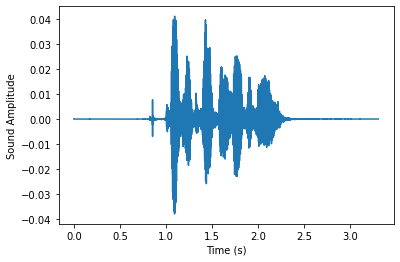

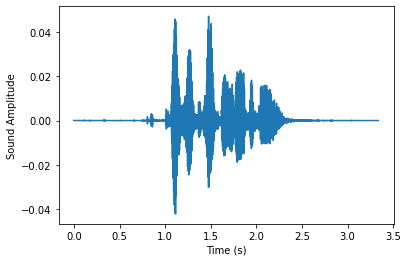

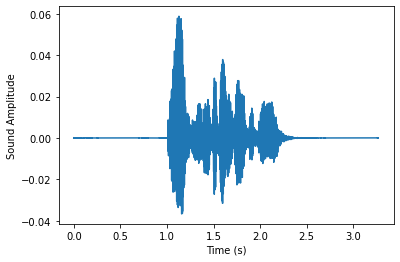

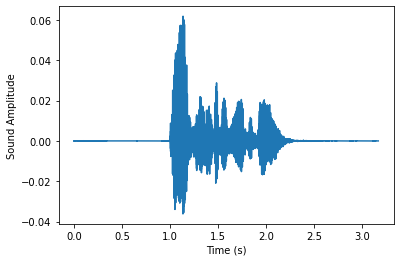

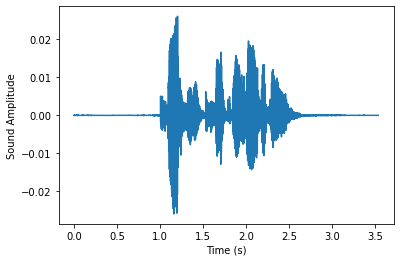

...

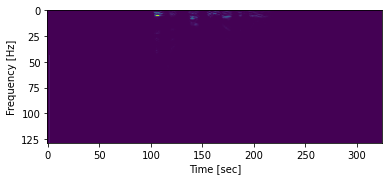

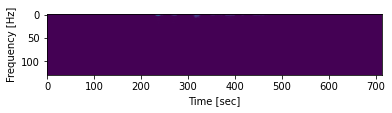

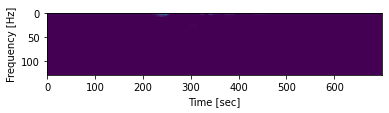

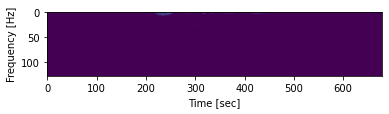

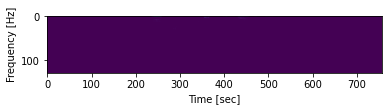

ValueError: too many values to unpack (expected 2)

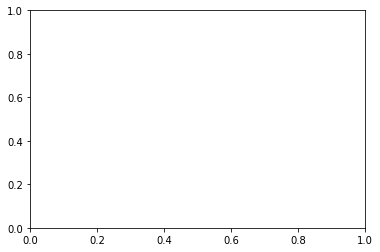

In [5]:
#Plotting the Basic Graphs for understanding of Audio Files :
for file in range(0 , len(listOfFiles) , 1):
    audio , sfreq = librosa.load(listOfFiles[file])
    time = np.arange(0 , len(audio)) / sfreq
    
    fig ,ax = plt.subplots()
    ax.plot(time , audio)
    ax.set(xlabel = 'Time (s)' , ylabel = 'Sound Amplitude')
    plt.show()
    
#PLOT THE SEPCTOGRAM
for file in range(0 , len(listOfFiles) , 1):
     sample_rate , samples = wavfile.read(listOfFiles[file])
     frequencies , times, spectrogram = signal.spectrogram(samples, sample_rate) 
     plt.pcolormesh(times, frequencies, spectrogram)
     plt.imshow(spectrogram)
     plt.ylabel('Frequency [Hz]')
     plt.xlabel('Time [sec]')
     plt.show()

### STEP 5 - VISUALIZATION OF AUDIO DATA

In [6]:
#Next Step is In-Depth Visualisation of Audio Fiels and its certain features to plot for.
#They are the Plotting Functions to be called later. 
def plot_signals(signals):
    fig , axes = plt.subplots(nrows=2, ncols=5,sharex =False , sharey=True, figsize=(20,5))
    fig.suptitle('Time Series' , size=16)
    i=0
    for x in range(2):
        for y in range(5):
            axes[x,y].set_title(list(signals.keys())[i])
            axes[x,y].plot(list(signals.values())[i])
            axes[x,y].get_xaxis().set_visible(False)
            axes[x,y].get_yaxis().set_visible(False)
            i +=1

def plot_fft(fft):
    fig , axes = plt.subplots(nrows=2, ncols=5,sharex =False , sharey=True, figsize=(20,5))
    fig.suptitle('Fourier Transform' , size=16)
    i=0
    for x in range(2):
        for y in range(5):
            data = list(fft.values())[i]
            Y,freq = data[0] , data[1]
            axes[x,y].set_title(list(fft.keys())[i])
            axes[x,y].plot(freq , Y)
            axes[x,y].get_xaxis().set_visible(False)
            axes[x,y].get_yaxis().set_visible(False)
            i +=1
    
def plot_fbank(fbank):
    fig , axes = plt.subplots(nrows=2, ncols=5,sharex =False , sharey=True, figsize=(20,5))
    fig.suptitle('Filter Bank Coefficients' , size=16)
    i=0
    for x in range(2):
        for y in range(5):
            axes[x,y].set_title(list(fbank.keys())[i])
            axes[x,y].imshow(list(fbank.values())[i],cmap='hot', interpolation = 'nearest')
            axes[x,y].get_xaxis().set_visible(False)
            axes[x,y].get_yaxis().set_visible(False)
            i +=1
            
def plot_mfccs(mfccs):
    fig , axes = plt.subplots(nrows=2, ncols=5,sharex =False , sharey=True, figsize=(20,5))
    fig.suptitle('Mel Frequency Capstrum  Coefficients' , size=16)
    i=0
    for x in range(2):
        for y in range(5):
            axes[x,y].set_title(list(mfccs.keys())[i])
            axes[x,y].imshow(list(mfccs.values())[i],
                             cmap='hot', interpolation = 'nearest')
            axes[x,y].get_xaxis().set_visible(False)
            axes[x,y].get_yaxis().set_visible(False)
            i +=1

def calc_fft(y,rate):
    n = len(y)
    freq = np.fft.rfftfreq(n , d= 1/rate)
    Y= abs(np.fft.rfft(y)/n)
    return(Y,freq)

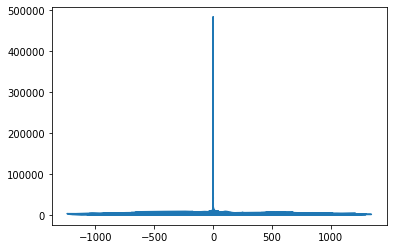

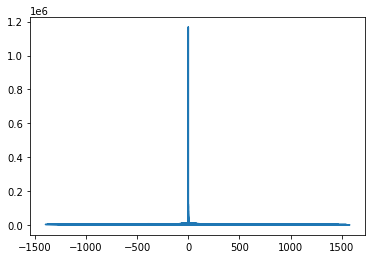

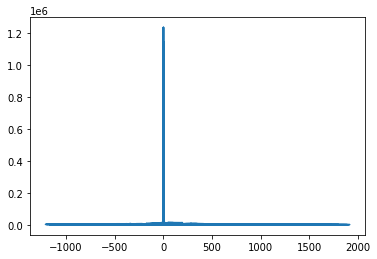

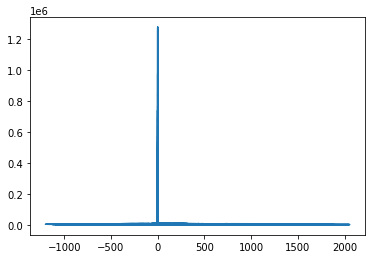

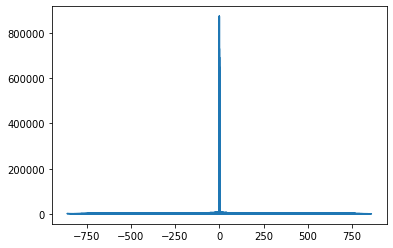

...

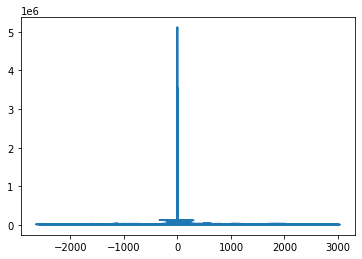

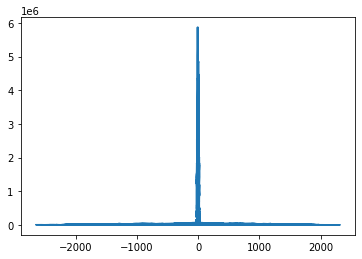

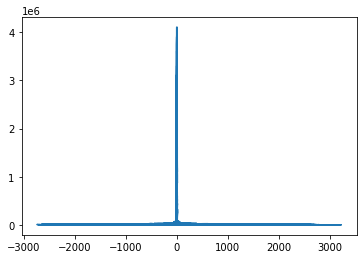

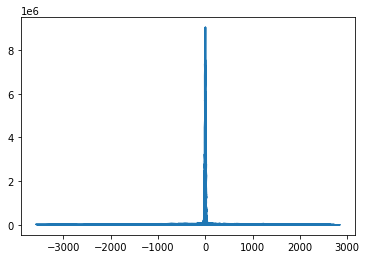

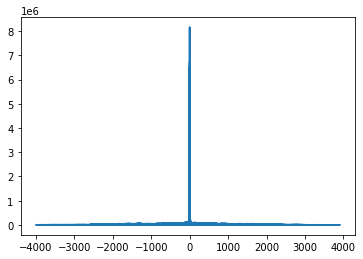

In [7]:
# Here The Data Set is loaded and plots are Visualised by Calling the Plotting Functions . 
import matplotlib.pyplot as plt
from scipy.io import wavfile as wav
from scipy.fftpack import fft
import numpy as np
for file in range(0 , len(listOfFiles) , 1):
    rate, data = wav.read(listOfFiles[file])
    fft_out = fft(data)
    %matplotlib inline
    plt.plot(data, np.abs(fft_out))
    plt.show()
    
signals={}
fft={}
fbank={}
mfccs={}
# load data
for file in range(0 , len(listOfFiles) , 1):
#     rate, data = wavfile.read(listOfFiles[file])
     signal,rate =librosa.load(listOfFiles[file] , sr=44100)
     mask = envelope(signal , rate , 0.0005)
     signals[file] = signal
     fft[file] = calc_fft(signal , rate)
    
     bank = logfbank(signal[:rate] , rate , nfilt = 26, nfft = 1103).T
     fbank[file] = bank
     mel = mfcc(signal[:rate] , rate , numcep =13 , nfilt = 26 , nfft=1103).T
     mfccs[file]=mel

plot_signals(signals)
plt.show()

plot_fft(fft)
plt.show()

plot_fbank(fbank)
plt.show()

plot_mfccs(mfccs)
plt.show()

### STEP 6 - CLEANING & MASKING

In [8]:
#Now Cleaning Step is Performed where:
#DOWN SAMPLING OF AUDIO FILES IS DONE  AND PUT MASK OVER IT AND DIRECT INTO CLEAN FOLDER
#MASK IS TO REMOVE UNNECESSARY EMPTY VOIVES AROUND THE MAIN AUDIO VOICE 
def envelope(y , rate, threshold):
    mask=[]
    y=pd.Series(y).apply(np.abs)
    y_mean = y.rolling(window=int(rate/10) ,  min_periods=1 , center = True).mean()
    for mean in y_mean:
        if mean>threshold:
            mask.append(True)
        else:
            mask.append(False)
    return mask

In [10]:
#The clean Audio Files are redirected to Clean Audio Folder Directory 
import glob,pickle
for file in tqdm(glob.glob(r'D:\Minor Project\speech-emotion-recognition-ravdess-data\\**\\*.wav')):
    file_name = os.path.basename(file)
    signal , rate = librosa.load(file, sr=16000)
    mask = envelope(signal,rate, 0.0005)
    wavfile.write(filename= r'D:\Minor Project\clean_speech\\'+str(file_name), rate=rate,data=signal[mask])

100%|██████████████████████████████████████████████████████████████████████████████| 1440/1440 [13:27<00:00,  1.78it/s]


### STEP 7 - FEATURE EXTRACTION

Define a function extract_feature to extract the mfcc, chroma, and mel features from a sound file. This function takes 4 parameters- the file name and three Boolean parameters for the three features:

**mfcc:** Mel Frequency Cepstral Coefficient, represents the short-term power spectrum of a sound

**chroma:** Pertains to the 12 different pitch classes

**mel: Mel Spectrogram Frequency**

In [11]:
#Feature Extraction of Audio Files Function 
#Extract features (mfcc, chroma, mel) from a sound file
def extract_feature(file_name, mfcc, chroma, mel):
    with soundfile.SoundFile(file_name) as sound_file:
        X = sound_file.read(dtype="float32")
        sample_rate=sound_file.samplerate
        if chroma:
            stft=np.abs(librosa.stft(X))
        result=np.array([])
        if mfcc:
            mfccs=np.mean(librosa.feature.mfcc(y=X, sr=sample_rate, n_mfcc=40).T, axis=0)
        result=np.hstack((result, mfccs))
        if chroma:
            chroma=np.mean(librosa.feature.chroma_stft(S=stft, sr=sample_rate).T,axis=0)
        result=np.hstack((result, chroma))
        if mel:
            mel=np.mean(librosa.feature.melspectrogram(X, sr=sample_rate).T,axis=0)
        result=np.hstack((result, mel))
    return result

### STEP 8 - LABELS CLASSIFICATION

Now, let’s define a dictionary to hold numbers and the emotions available in the RAVDESS dataset, and a list to hold those we want- calm, happy, fearful, disgust.

In [12]:
#Emotions in the RAVDESS dataset to be classified Audio Files based on . 
emotions={
  '01':'neutral',
  '02':'calm',
  '03':'happy',
  '04':'sad',
  '05':'angry',
  '06':'fearful',
  '07':'disgust',
  '08':'surprised'
}
#These are the emotions User wants to observe more :
observed_emotions=['calm', 'happy', 'fearful', 'disgust']

### STEP 9 - LOADING OF DATA & SPLITTING OF DATASET

Now, let’s load the clean data with a function load_data() – this takes in the relative size of the test set as parameter. x and y are empty lists; we’ll use the glob() function from the glob module to get all the pathnames for the sound files in our dataset,

In [13]:
#Load the clean data
from glob import glob
import os
import glob
def load_data(test_size=0.33):
    x,y=[],[]
    answer = 0
    for file in glob.glob(r'D:\Minor Project\clean_speech\\*.wav'):
        file_name=os.path.basename(file)
        emotion=emotions[file_name.split("-")[2]]
        if emotion not in observed_emotions:
            answer += 1
            continue
        feature=extract_feature(file, mfcc=True, chroma=True, mel=True)
        x.append(feature)
        y.append([emotion,file_name])
    return train_test_split(np.array(x), y, test_size=test_size, random_state=9)

Time to split the dataset into training and testing sets! Let’s keep the test set 25% of everything and use the load_data function for this.

In [14]:
#Split the dataset
import librosa
import numpy as np
x_train,x_test,y_trai,y_tes=load_data(test_size=0.25)
print(np.shape(x_train),np.shape(x_test), np.shape(y_trai),np.shape(y_tes))
y_test_map = np.array(y_tes).T
y_test = y_test_map[0]
test_filename = y_test_map[1]
y_train_map = np.array(y_trai).T
y_train = y_train_map[0]
train_filename = y_train_map[1]
print(np.shape(y_train),np.shape(y_test))
print(*test_filename,sep="\n")

(576, 180) (192, 180) (576, 2) (192, 2)
(576,) (192,)
03-01-06-01-02-02-01.wav
03-01-03-01-02-01-21.wav
03-01-07-01-02-02-04.wav
03-01-02-02-01-02-24.wav
03-01-07-01-02-02-19.wav
03-01-06-01-01-01-07.wav
03-01-07-01-01-01-16.wav
03-01-02-01-02-02-06.wav
03-01-06-01-01-02-07.wav
03-01-06-02-01-01-15.wav
03-01-02-02-02-02-07.wav
03-01-06-01-02-02-19.wav
03-01-06-02-02-02-05.wav
03-01-06-01-01-01-14.wav
03-01-06-01-02-01-15.wav
03-01-03-02-02-01-06.wav
03-01-02-01-01-02-16.wav
03-01-07-01-01-01-13.wav
03-01-03-02-02-02-24.wav
03-01-02-01-02-02-19.wav
03-01-02-02-01-02-09.wav
03-01-02-01-01-02-07.wav
03-01-03-01-02-01-13.wav
03-01-02-01-02-01-18.wav
03-01-02-02-02-02-03.wav
03-01-02-02-01-01-11.wav
03-01-03-01-02-02-20.wav
03-01-03-02-01-02-06.wav
03-01-06-01-01-02-11.wav
03-01-03-01-02-01-18.wav
03-01-06-01-01-01-15.wav
03-01-07-02-01-02-08.wav
03-01-07-02-01-02-23.wav
03-01-03-01-02-02-10.wav
03-01-06-01-01-01-23.wav
03-01-07-02-02-01-18.wav
03-01-06-02-02-01-22.wav
03-01-07-02-01-01-21.

In [15]:
#Get the shape of the training and testing datasets
# print((x_train.shape[0], x_test.shape[0]))
print((x_train[0], x_test[0]))
#Get the number of features extracted
print(f'Features extracted: {x_train.shape[1]}')

(array([-4.73242371e+02,  6.49476013e+01,  5.06625128e+00,  2.38717937e+01,
       -1.97416821e+01, -7.14303255e+00, -9.22696972e+00, -1.63594055e+00,
       -5.45382929e+00,  1.04155159e+01, -2.57473111e+00, -2.86550736e+00,
       -2.09127641e+00,  2.69892263e+00, -8.69563580e+00,  1.02849174e+00,
       -7.19070387e+00,  1.02750850e+00, -7.98289156e+00, -4.32630587e+00,
       -6.31677437e+00, -2.39516675e-01, -6.42635202e+00,  3.87687445e-01,
       -1.03465614e+01,  6.57261133e+00, -3.56554532e+00,  2.10259724e+00,
       -3.64155769e+00, -4.39486176e-01, -1.11321580e+00,  1.33554351e+00,
       -6.56615400e+00, -3.12640119e+00, -9.13692093e+00, -2.58903313e+00,
       -1.92057061e+00, -5.91157854e-01, -6.16486025e+00, -3.78921366e+00,
        6.49149477e-01,  6.20812893e-01,  6.59423709e-01,  6.82692051e-01,
        7.25170195e-01,  7.69427478e-01,  7.38093913e-01,  6.58926547e-01,
        7.17005014e-01,  7.16384232e-01,  6.44732893e-01,  6.45568132e-01,
        3.15672019e-04, 

### STEP 10 - APPLY MLP CLASSIFIER

Now, let’s Apply a MLPClassifier. This is a Multi-layer Perceptron Classifier; it optimizes the log-loss function using LBFGS or stochastic gradient descent. Unlike SVM or Naive Bayes, the MLPClassifier has an internal neural network for the purpose of classification. This is a feedforward ANN model.

In [16]:
# Apply Multi Layer Perceptron Classifier
model=MLPClassifier(alpha=0.01, batch_size=256, epsilon=1e-08, hidden_layer_sizes=(300,), learning_rate='adaptive', max_iter=500)

In [17]:
#Train the model
model.fit(x_train,y_train)

MLPClassifier(alpha=0.01, batch_size=256, hidden_layer_sizes=(300,),
              learning_rate='adaptive', max_iter=500)

### STEP 11 - SAVING THE MODEL

In [18]:
#SAVING THE MODEL
import pickle
# Save the Modle to file in the current working directory
#For any new testing data other than the data in dataset

Pkl_Filename = "Speech_Emotions_Recognition_Model.pkl"  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(model, file)

### STEP 11 - LOAD THE SAVED MODEL

In [19]:
# Load the Model back from file
with open(Pkl_Filename, 'rb') as file:  
    Speech_Emotions_Recognition_Model = pickle.load(file)

Speech_Emotions_Recognition_Model

MLPClassifier(alpha=0.01, batch_size=256, hidden_layer_sizes=(300,),
              learning_rate='adaptive', max_iter=500)

### STEP 12 - PREDICT THE TEST DATA USING THE SAVED MODEL

Let’s predict the values for the test set from saved model. This gives us y_pred (the predicted emotions for the features in the test set).

In [20]:
#predicting :
y_pred=Speech_Emotions_Recognition_Model.predict(x_test)
y_pred

array(['happy', 'happy', 'fearful', 'calm', 'disgust', 'calm', 'disgust',
       'calm', 'happy', 'fearful', 'calm', 'fearful', 'fearful',
       'fearful', 'disgust', 'happy', 'disgust', 'disgust', 'fearful',
       'calm', 'calm', 'calm', 'happy', 'calm', 'calm', 'calm', 'fearful',
       'happy', 'disgust', 'calm', 'calm', 'disgust', 'disgust', 'happy',
       'fearful', 'disgust', 'fearful', 'disgust', 'disgust', 'disgust',
       'disgust', 'calm', 'disgust', 'fearful', 'fearful', 'calm',
       'fearful', 'disgust', 'calm', 'calm', 'happy', 'happy', 'happy',
       'calm', 'disgust', 'disgust', 'happy', 'happy', 'happy', 'calm',
       'disgust', 'happy', 'disgust', 'calm', 'disgust', 'happy',
       'disgust', 'happy', 'fearful', 'disgust', 'disgust', 'calm',
       'calm', 'calm', 'disgust', 'calm', 'disgust', 'happy', 'happy',
       'disgust', 'fearful', 'disgust', 'happy', 'happy', 'disgust',
       'fearful', 'disgust', 'disgust', 'calm', 'fearful', 'calm',
       'happy', 

### STEP 13 - SUMMARIZATION OF PREDICTED DATA

To calculate the accuracy of our model, we’ll call up the accuracy_score() function we imported from sklearn. Finally, we’ll round the accuracy to 2 decimal places and print it out.

In [21]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report

results = confusion_matrix(y_test, y_pred)

print('Confusion Matrix')
print(results)
print("Accuracy Score:", accuracy_score(y_test, y_pred))
print("Report")
print(classification_report(y_test, y_pred))

Confusion Matrix
[[45  5  3  1]
 [ 4 37  1  2]
 [ 5  9 32  7]
 [ 2  4  5 30]]
Accuracy Score: 0.75
Report
              precision    recall  f1-score   support

        calm       0.80      0.83      0.82        54
     disgust       0.67      0.84      0.75        44
     fearful       0.78      0.60      0.68        53
       happy       0.75      0.73      0.74        41

    accuracy                           0.75       192
   macro avg       0.75      0.75      0.75       192
weighted avg       0.76      0.75      0.75       192



In [22]:
#Calculate the accuracy of our model
accuracy=accuracy_score(y_true=y_test, y_pred=y_pred)

#Print the accuracy
print("Accuracy: {:.2f}%".format(accuracy*100))

Accuracy: 75.00%


### STEP 14 - STORE THE PREDICTED FILE IN .CSV FILE

In [23]:
#Store the Prediction probabilities into CSV file 
import numpy as np
import pandas as pd
y_pred1 = pd.DataFrame(y_pred, columns=['predictions'])
y_pred1['file_names'] = test_filename
print(y_pred1)
y_pred1.to_csv('predictionfinal.csv')

    predictions                file_names
0         happy  03-01-06-01-02-02-01.wav
1         happy  03-01-03-01-02-01-21.wav
2       fearful  03-01-07-01-02-02-04.wav
3          calm  03-01-02-02-01-02-24.wav
4       disgust  03-01-07-01-02-02-19.wav
..          ...                       ...
187     disgust  03-01-07-01-02-02-14.wav
188       happy  03-01-03-02-02-02-02.wav
189     fearful  03-01-06-02-01-01-14.wav
190     disgust  03-01-07-01-01-02-02.wav
191     disgust  03-01-02-02-02-01-22.wav

[192 rows x 2 columns]


# END